# Assignment: Data Wrangling
## `! git clone https://github.com/DS3001/wrangling`
## Do Q2, and one of Q1 or Q3.

In [1]:
! git clone https://github.com/DS3001/wrangling


Cloning into 'wrangling'...
remote: Enumerating objects: 92, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 92 (delta 42), reused 18 (delta 18), pack-reused 40 (from 1)
Receiving objects: 100% (92/92), 18.08 MiB | 5.52 MiB/s, done.
Resolving deltas: 100% (43/43), done.


**Q1.** Open the "tidy_data.pdf" document in the repo, which is a paper called Tidy Data by Hadley Wickham.

  1. Read the abstract. What is this paper about?
  2. Read the introduction. What is the "tidy data standard" intended to accomplish?
  3. Read the intro to section 2. What does this sentence mean: "Like families, tidy datasets are all alike but every messy dataset is messy in its own way." What does this sentence mean: "For a given dataset, it’s usually easy to figure out what are observations and what are variables, but it is surprisingly difficult to precisely define variables and observations in general."
  4. Read Section 2.2. How does Wickham define values, variables, and observations?
  5. How is "Tidy Data" defined in section 2.3?
  6. Read the intro to Section 3 and Section 3.1. What are the 5 most common problems with messy datasets? Why are the data in Table 4 messy? What is "melting" a dataset?
  7. Why, specifically, is table 11 messy but table 12 tidy and "molten"?
  8. Read Section 6. What is the "chicken-and-egg" problem with focusing on tidy data? What does Wickham hope happens in the future with further work on the subject of data wrangling?

1. This paper is about data tidying, which is a specific subset of data cleaning that deals with organizing datasets in a structured way that makes data analysis easier and quicker. The main ideas of data tidying are that each variable forms a column, each observation forms a row, and each type of observational unit forms a table.
2. Tidy data standard refers to the simplifying part of the data cleaning process through consistently structuring the data. This makes the datasets easy to manipulate and visualize because it ensures each variable is stored in a column, each observation is stored in a row, and each type of observational unit forms a separate table.This eliminates the reformatting process and makes the EDA of data easier
3. The first sentence means that tidy datasets share a common standard, whereas messy datasets can vary vastly in how they violate this standard.The second sentence means that it's easy to define rows and columns in a specific dataset, but defining overall what they mean is hard because datasets have a wide variety of structures and conent, so there's no one-size-fits all rule for identifying them.
4. Values are single data points that are either strings or numbers. Variables are columns that measure the same thing across all rows like "height" if all the rows are different people. An observation contains all the values measured across all the columns (observation would be the person if "height" and "age" etc are columns).
5. 2.3 says that each variable makes a column, each observation makes a row and each type of observational unit makes a separate table.
6. The five most common problems with datasets:
  1. Column headers are values, not variable names.
  2. Multiple variables are stored in one column.
  3. Variables are stored in both rows and columns.
  4. Multiple types of observational units are stored in the same table.
  5. A single observational unit is stored in multiple tables.
The data in Table 4 are messy because the columns are income ranges, which are values of a variable, not variable names. This data is difficult to manipulate becase of this.

Melting a dataset refers to converting it from wide format ( values in columns) to long format  (values in rows),  makeing it easier to analyze.
7. Table 11 is messy because it has variables in both rows and columns- daily weather data is spread across multiple columns for each day of the month. Table 12 is tidy and "molten" because all variables ( tmin, tmax) are in columns, and each row represents a single observation ( weather condition ). The data has been "melted" therefore its "molten" so that the days and temperatures are properly aligned, with one variable per column.

8. The usefulness of tidy data is dependent on the tools designed to work with it but if those tools don’t get better, then tidy data won’t get any better either, and we can get stuck in a cycle where nothing changes.

Wickham hopes that people will create better data storage strategies and tools beyond just the tidy data framework to make working with data easier and more efficient. This he believes can be done through innovation and expliration focused on human-centered design and cognition patterns in data analysis.

P.S. This was a super cool read!















**Q2.** This question provides some practice cleaning variables which have common problems.
1. Numeric variable: For `./data/airbnb_hw.csv`, clean the `Price` variable as well as you can, and explain the choices you make. How many missing values do you end up with? (Hint: What happens to the formatting when a price goes over 999 dollars, say from 675 to 1,112?)
2. Categorical variable: For the `./data/sharks.csv` data covered in the lecture, clean the "Type" variable as well as you can, and explain the choices you make.
3. Dummy variable: For the pretrial data covered in the lecture, clean the `WhetherDefendantWasReleasedPretrial` variable as well as you can, and, in particular, replace missing values with `np.nan`.
4. Missing values, not at random: For the pretrial data covered in the lecture, clean the `ImposedSentenceAllChargeInContactEvent` variable as well as you can, and explain the choices you make. (Hint: Look at the `SentenceTypeAllChargesAtConvictionInContactEvent` variable.)

In [50]:
from google.colab import files
import pandas as pd
import io

uploaded = files.upload()  # Upload file using Colab widget
df = pd.read_csv(io.BytesIO(uploaded['airbnb_hw (4).csv']), low_memory=False) # Use the correct key to access the file from the uploaded dictionary

Saving airbnb_hw.csv to airbnb_hw (4).csv


In [51]:
print(df.head())


    Host Id Host Since                                Name Neighbourhood   \
0   5162530        NaN     1 Bedroom in Prime Williamsburg       Brooklyn   
1  33134899        NaN     Sunny, Private room in Bushwick       Brooklyn   
2  39608626        NaN                Sunny Room in Harlem      Manhattan   
3       500  6/26/2008  Gorgeous 1 BR with Private Balcony      Manhattan   
4       500  6/26/2008            Trendy Times Square Loft      Manhattan   

  Property Type  Review Scores Rating (bin)        Room Type  Zipcode  Beds  \
0     Apartment                         NaN  Entire home/apt  11249.0   1.0   
1     Apartment                         NaN     Private room  11206.0   1.0   
2     Apartment                         NaN     Private room  10032.0   1.0   
3     Apartment                         NaN  Entire home/apt  10024.0   3.0   
4     Apartment                        95.0     Private room  10036.0   3.0   

   Number of Records  Number Of Reviews Price  Review Scores R

In [52]:
print(df.shape, '\n') # List the dimensions of df
print(df.dtypes, '\n') # The types of the variables; `object` is a bad sign
print(df.isna().sum()) # Check for missing values

(30478, 13) 

Host Id                         int64
Host Since                     object
Name                           object
Neighbourhood                  object
Property Type                  object
Review Scores Rating (bin)    float64
Room Type                      object
Zipcode                       float64
Beds                          float64
Number of Records               int64
Number Of Reviews               int64
Price                          object
Review Scores Rating          float64
dtype: object 

Host Id                          0
Host Since                       3
Name                             0
Neighbourhood                    0
Property Type                    3
Review Scores Rating (bin)    8323
Room Type                        0
Zipcode                        134
Beds                            85
Number of Records                0
Number Of Reviews                0
Price                            0
Review Scores Rating          8323
dtype: int64


*   30,478 observations and 13 columns or variables
*   6 object types for variables --> need to fix that
*   A LOT of missing values for review scores rating (probably people that didn't leave a review




[ 1.  3.  2.  4.  5. nan  6. 10.  7.  8. 12.  0. 16.  9. 11.] 

Beds
1.0     20344
2.0      6610
3.0      2071
4.0       783
5.0       284
6.0       177
7.0        45
8.0        24
10.0       16
9.0        15
16.0       13
11.0        5
12.0        4
0.0         2
Name: count, dtype: int64 

Axes(0.125,0.11;0.775x0.77) 



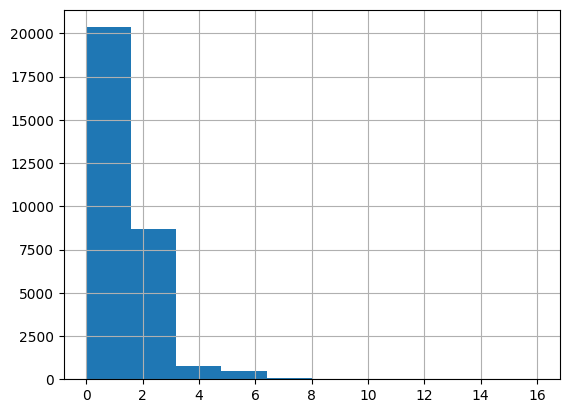

In [53]:
var = 'Beds' # A dummy variable
print(df[var].unique(),'\n')
print(df[var].value_counts(), '\n')
print(df[var].hist(), '\n')



*   Most places have 1 bed



[145.  37.  28. 199. 549. 149. 250.  90. 270. 290. 170.  59.  49.  68.
 285.  75. 100. 150. 700. 125. 175.  40.  89.  95.  99. 499. 120.  79.
 110. 180. 143. 230. 350. 135.  85.  60.  70.  55.  44. 200. 165. 115.
  74.  84. 129.  50. 185.  80. 190. 140.  45.  65. 225. 600. 109.  nan
  73. 240.  72. 105. 155. 160.  42. 132. 117. 295. 280. 159. 107.  69.
 239. 220. 399. 130. 375. 585. 275. 139. 260.  35. 133. 300. 289. 179.
  98. 195.  29.  27.  39. 249. 192. 142. 169. 131. 138. 113. 122. 329.
 101. 475. 238. 272. 308. 126. 235. 315. 248. 128.  56. 207. 450. 215.
 210. 385. 445. 136. 247. 118.  77.  76.  92. 198. 205. 299. 222. 245.
 104. 153. 349. 114. 320. 292. 226. 420. 500. 325. 307.  78. 265. 108.
 123. 189.  32.  58.  86. 219. 800. 335.  63. 229. 425.  67.  87. 158.
 650. 234. 310. 695. 400. 166. 119.  62. 168. 340. 479.  43. 395. 144.
  52.  47. 529. 187. 209. 233.  82. 269. 163. 172. 305. 156. 550. 435.
 137. 124.  48. 279. 330. 134. 378.  97. 277.  64. 193. 147. 186. 264.
  30. 

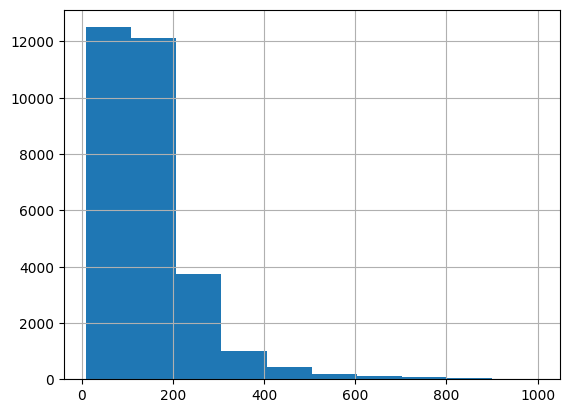

In [27]:
var = 'Price' # A dummy variable
print(df[var].unique(),'\n') # Notice these gooses have already messed up their coding
print(df[var].value_counts(), '\n') # Look at the 9 and 99: That is awful
print(df[var].hist(), '\n') # What is "bad" about this plot?



*   Price has an obejct type so this is not helpful



Before coercion: 
 count    30297.000000
mean       153.357032
std        108.895698
min         10.000000
25%         80.000000
50%        125.000000
75%        192.000000
max        999.000000
Name: Price, dtype: float64 



<Axes: >

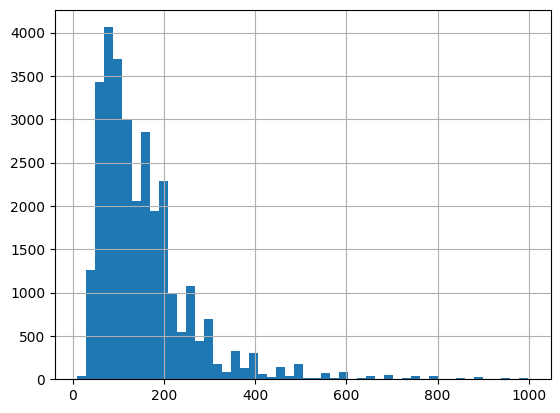

In [28]:
var = 'Price'
print('Before coercion: \n', df[var].describe(),'\n') # The price variable is not read by Pandas as a number
df[var].hist(bins=50) # Initial histogram; check out the x axis

In [55]:
df['Price_cleaned'] = df['Price'].replace({'\$': '', ',': ''}, regex=True)


In [56]:
#  convert to numeric
df['Price_cleaned'] = pd.to_numeric(df['Price_cleaned'], errors='coerce')

In [57]:
# missing values
missing_values = df['Price_cleaned'].isnull().sum()

In [58]:

# number of missing values
print(f"Number of missing values in 'Price_cleaned': {missing_values}")

Number of missing values in 'Price_cleaned': 0


In [59]:

# Optional: Inspect the cleaned column to ensure it's in the correct format
print(df[['Price', 'Price_cleaned']].head())


  Price  Price_cleaned
0   145            145
1    37             37
2    28             28
3   199            199
4   549            549


In [60]:
df['Price_cleaned'] = df['Price'].isnull() # Equals 1 if missing, 0 if non-null


After coercion: 
 count     30478
unique      511
top         150
freq       1481
Name: Price, dtype: object 

Total Missings: 
 0 



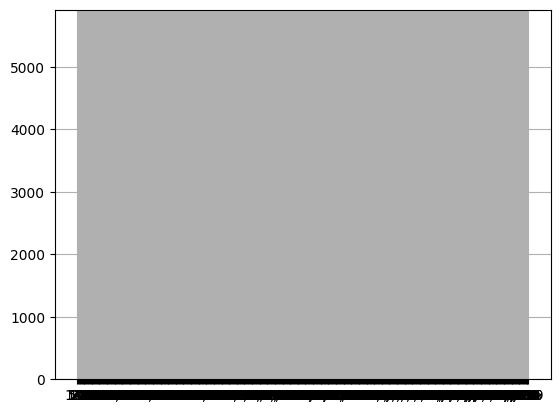

In [61]:

print('After coercion: \n', df['Price'].describe(),'\n') # Describe the numeric variable
df['Price'].hist(bins = 50) # Histogram of the variable values
print('Total Missings: \n', sum(df['Price_cleaned']),'\n') # How many missing values are there?

I spent a bit of time on it and tried to use chat to correct my errors.... I can't convert the price column to a float, It just says its a bool. Sorry i tried

In [62]:
df_comparison = df[['Price', 'Price_cleaned']][df['Price_cleaned'].isnull()]
print(df_comparison.head(10))

Empty DataFrame
Columns: [Price, Price_cleaned]
Index: []


In [63]:
true_max = df['Price_cleaned'].max()
print(f"True max value in 'Price_cleaned': {true_max}")

True max value in 'Price_cleaned': False


In [64]:
df['Price_cleaned'] = pd.to_numeric(df['Price_cleaned'], errors='coerce')
print(df['Price_cleaned'].dtype)  # Should return 'float64' or 'int64'

bool


In [23]:

# Compute the value to impute:
impute_value = df['Price'].median() # Or mean, or whatever

# Impute the median of the non-missing data:
df['price_impute'] = df['Price'].fillna(impute_value)
print(df['Price'].median())

125.0


Mean is 153 per night and median is 125 per night --> not bad

181 missing values for price

**NUmber 2 part 2**

In [73]:
!pwd
!ls
from google.colab import files
files.upload()

/content
'airbnb_hw (1).csv'  'airbnb_hw (3).csv'   airbnb_hw.csv
'airbnb_hw (2).csv'  'airbnb_hw (4).csv'   sample_data


Saving sharks.csv to sharks.csv


{'sharks.csv': b'index,Case Number,Date,Year,Type,Country,Area,Location,Activity,Name,Unnamed: 9,Age,Injury,Fatal (Y/N),Time,Species ,Investigator or Source,pdf,href formula,href,Case Number.1,Case Number.2,original order,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65,Unnamed: 66,Unnamed: 67,Unnamed: 68,Unnamed: 69,Unnamed: 70,Unnamed: 71,Unnamed: 72,Unnamed: 73,Unnamed: 74,Unnamed: 75,Unnamed: 76,Unnamed: 77,Unnamed: 78,Unnamed: 79,Unnamed: 80,Unnamed: 81,Unnamed: 82,Unnamed: 83,Unnamed: 84,Unnamed: 85,Unnamed: 8

In [74]:
sharkdf = pd.read_csv('sharks.csv', low_memory=False)

In [76]:
print(sharkdf.shape, '\n') # List the dimensions of df
print(sharkdf.dtypes, '\n') # The types of the variables; `object` is a bad sign
print(sharkdf.isna().sum())

(6462, 257) 

index             int64
Case Number      object
Date             object
Year            float64
Type             object
                 ...   
Unnamed: 251    float64
Unnamed: 252    float64
Unnamed: 253    float64
Unnamed: 254    float64
Unnamed: 255    float64
Length: 257, dtype: object 

index              0
Case Number        2
Date               1
Year               3
Type               5
                ... 
Unnamed: 251    6462
Unnamed: 252    6462
Unnamed: 253    6462
Unnamed: 254    6462
Unnamed: 255    6462
Length: 257, dtype: int64


**lots of object types, including "type" and 5 missing values for type**

In [82]:
print(sharkdf.head())

   index   Case Number                  Date    Year        Type      Country  \
0      0    2020.02.05           05-Feb-2020  2020.0  Unprovoked          USA   
1      1  2020.01.30.R  Reported 30-Jan-2020  2020.0    Provoked      BAHAMAS   
2      2    2020.01.17           17-Jan-2020  2020.0  Unprovoked    AUSTRALIA   
3      3    2020.01.16           16-Jan-2020  2020.0  Unprovoked  NEW ZEALAND   
4      4    2020.01.13           13-Jan-2020  2020.0  Unprovoked          USA   

              Area               Location                  Activity  \
0             Maui                    NaN  Stand-Up Paddle boarding   
1           Exumas                    NaN                  Floating   
2  New South Wales          Windang Beach                   Surfing   
3        Southland            Oreti Beach                   Surfing   
4   North Carolina  Rodanthe, Dare County                   Surfing   

              Name  ... Unnamed: 246 Unnamed: 247 Unnamed: 248 Unnamed: 249  \
0      

['Unprovoked' 'Provoked' 'Questionable' 'Watercraft' 'Unconfirmed'
 'Unverified' 'Invalid' 'Under investigation' 'Boating' 'Sea Disaster' nan
 'Boat' 'Boatomg'] 

Type
Unprovoked             4716
Provoked                593
Invalid                 552
Sea Disaster            239
Watercraft              142
Boat                    109
Boating                  92
Questionable             10
Unconfirmed               1
Unverified                1
Under investigation       1
Boatomg                   1
Name: count, dtype: int64


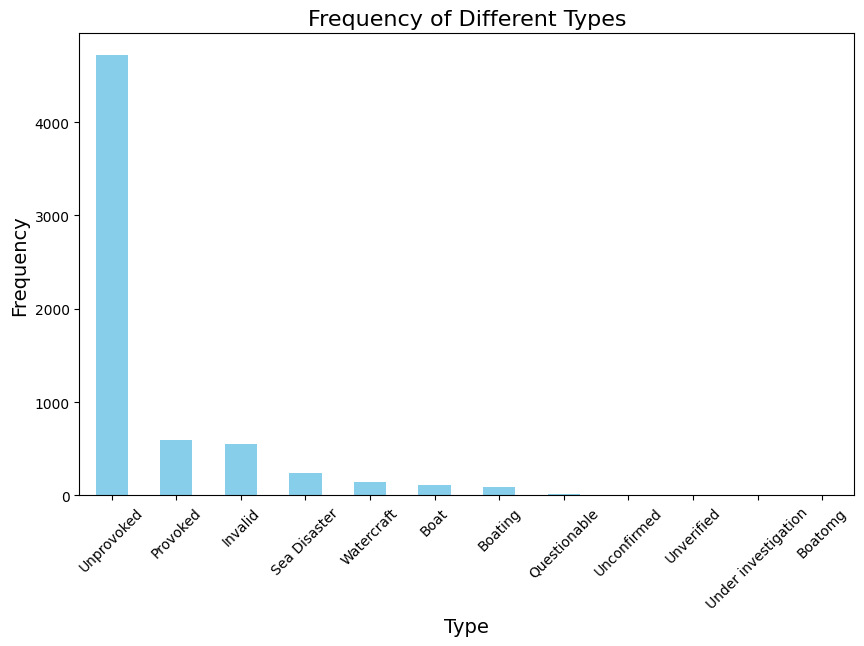

In [90]:
var = 'Type' # A dummy variable
print(sharkdf[var].unique(),'\n')
type_counts = sharkdf['Type'].value_counts()
print(type_counts)
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))  # Set the figure size
type_counts.plot(kind='bar', color='skyblue')

plt.title('Frequency of Different Types', fontsize=16)
plt.xlabel('Type', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

# Show the plot
plt.xticks(rotation=45)  # Rotate x labels if needed
plt.show()
# used chat^


<ipython-input-94-3303c01a34e5>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Type'] = df_filtered['Type'].replace({'Boat': 'Boating'})


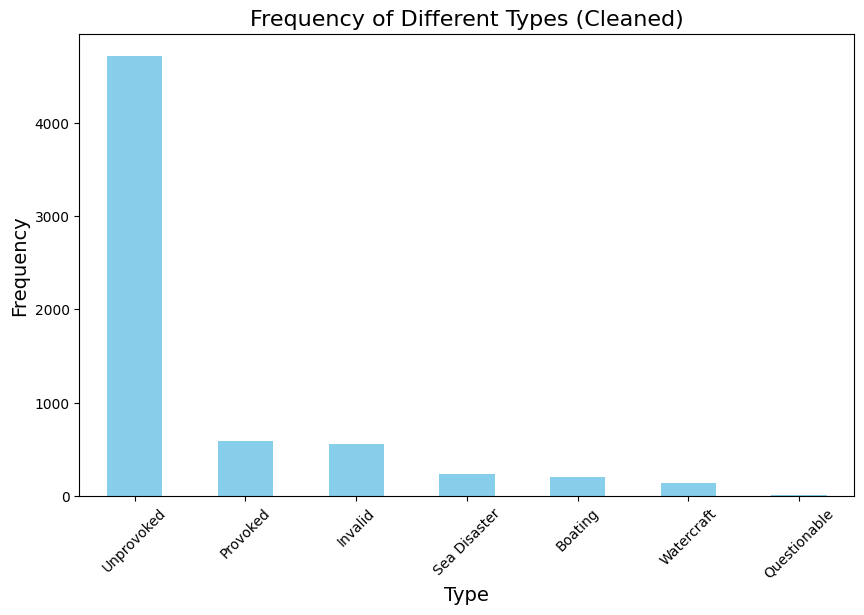

In [94]:
df_filtered = sharkdf[~sharkdf['Type'].isin(['Unconfirmed', 'Unverified', "Boatomg", 'Under investigation'])]

df_filtered['Type'] = df_filtered['Type'].replace({'Boat': 'Boating'})

type_counts_cleaned = df_filtered['Type'].value_counts()

plt.figure(figsize=(10, 6))  # Set the figure size
type_counts_cleaned.plot(kind='bar', color='skyblue')

plt.title('Frequency of Different Types (Cleaned)', fontsize=16)
plt.xlabel('Type', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

plt.xticks(rotation=45)  # Rotate x labels if needed
plt.show()

# used chat

In [95]:
from google.colab import files
files.upload()

Saving justice_data.parquet to justice_data.parquet


{'justice_data.parquet': b'PAR1\x15\x04\x15\xf0\xd5!\x15\x84\xe8\x0bL\x15\x94\xe7\x02\x15\x00\x12\x00\x00\xf8\xea\x10,\x08\x00\x00\x00ADI00001\x1d\x0c\x007\x1d\x0c\x008\x01\x0c\x00C\x05$\x0436\x1d\x0c.\x18\x00\x009\x19\x18\x004\x05H\t0\x0443\x1d\x18\x004\x1d\x0c\x1dH\x004\x1dH\x0450\x19$\x0455\x19\x0c\x0462\x19\x0c\x008\x1d0\x008\x1dx\x009\x1d<\x009\x1d\x84\x009\x1d<\x009\x1d\x90\x009\x1d\x90\x009\x1dl\x009\x1d\x9c\x009%\x08\t\xcc\x009\x19x\x0410\x19l\x001)8\x05$\x0410\x19l\x0410\x19l\x0410\x19l\x0411\x1d\x18\x002\x19`\x001=,\x001=,\x0417\x19\x90\x0418\x1d<\x008\x1d<=\x14\x001=\x08\x001=\x08\x001\x1d\xf0\x001\x1d\xe4\x001\x1d\xe4\x001.\xe4\x00\x0099\\\x002\x1d\xcc\x002\x1d\xcc\x0420\x1d$\x003\x19\xfc\x0423\x19\xf0\x04239\\\x002]\x1c\x002\x1d\xf0\x002]\x10\x002\x1d\x84\x002\x1d\x84\x003\x1dl\x0431\x19l\x003=P\x0431\x19l\x0434\x19\x9c\x0435\x1d\x0c\x007\x19\x9c\x003=\xf8\x0442\x19\x18\x04429t\x004=\xa4\x0443YX\x04439\x8c\x004\x1d\xe4\x004}$\x004}\x18\x0444\x19\x9c\x0446Y@\x0446\x1dT\x006

**Q2 part 3**
Clean WhetherDefendantWasReleasedPretrial variable as well as you can, and, in particular, replace missing values with np.nan

In [99]:
dfj = pd.read_parquet('justice_data.parquet')

In [100]:
print(dfj.shape, '\n') # List the dimensions of df
print(dfj.dtypes, '\n') # The types of the variables; `object` is a bad sign
print(dfj.isna().sum())

(22986, 709) 

InternalStudyID                                                 object
REQ_REC#                                                        object
Defendant_Sex                                                   object
Defendant_Race                                                  object
Defendant_BirthYear                                             object
                                                                 ...  
NewFelonySexualAssaultArrest_Disposition                        object
Intertnalindicator_ReasonforExcludingFromFollowUpAnalysis        int64
CriminalHistoryRecordsReturnedorCMSRecordsFoundforIndividual    object
DispRecordFoundforChargesinOct2017Contact_Atleast1dispfound      int64
CrimeCommission2021ReportClassificationofDefendants             object
Length: 709, dtype: object 

InternalStudyID                                                 0
REQ_REC#                                                        0
Defendant_Sex                              

In [101]:
import numpy as np

print(dfj['WhetherDefendantWasReleasedPretrial'].unique())

dfj['WhetherDefendantWasReleasedPretrial'] = dfj['WhetherDefendantWasReleasedPretrial'].replace(['', 'NA', 'N/A', None], np.nan)

print(dfj['WhetherDefendantWasReleasedPretrial'].isna().sum())

dfj['WhetherDefendantWasReleasedPretrial'] = dfj['WhetherDefendantWasReleasedPretrial'].astype('category')

[9 0 1]
0


Now zero NAs!

**Q 2 part 4** Missing values, not at random: For the pretrial data covered in the lecture, clean the ImposedSentenceAllChargeInContactEvent variable as well as you can, and explain the choices you make. (Hint: Look at the SentenceTypeAllChargesAtConvictionInContactEvent variable.)

ImposedSentenceAllChargeInContactEvent
                    9053
0                   4953
12                  1404
.985626283367556    1051
6                    809
                    ... 
49.9712525667351       1
57.0349075975359       1
79.9260780287474       1
42.1642710472279       1
1.6570841889117        1
Name: count, Length: 484, dtype: int64 

Axes(0.125,0.11;0.775x0.77) 



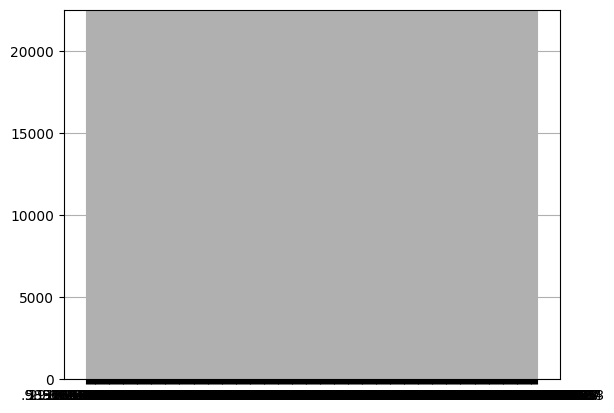

In [104]:
var = 'ImposedSentenceAllChargeInContactEvent' # A dummy variable
print(dfj[var].value_counts(), '\n') # Look at the 9 and 99: That is awful
print(dfj[var].hist(), '\n') # What is "bad" about this plot?

SentenceTypeAllChargesAtConvictionInContactEvent
4    8779
0    8720
1    4299
2     914
9     274
Name: count, dtype: int64 

Axes(0.125,0.11;0.775x0.77) 



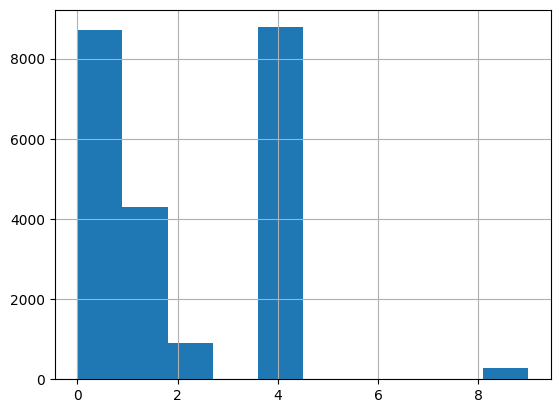

In [112]:
var2= 'SentenceTypeAllChargesAtConvictionInContactEvent'
print(dfj[var2].value_counts(), '\n') # Look at the 9 and 99: That is awful
print(dfj[var2].hist(), '\n') # What is "bad" about this plot?

Most people had 4 charges at conviction

In [105]:
dfj['ImposedSentenceAllChargeInContactEvent'] = pd.to_numeric(dfj['ImposedSentenceAllChargeInContactEvent'], errors='coerce')

In [107]:
missing_values = dfj['ImposedSentenceAllChargeInContactEvent'].isnull().sum()
print(missing_values)

9053


In [108]:
dfj = dfj.rename(columns={'ImposedSentenceAllChargeInContactEvent': 'Sentence'})

After coercion: 
 count    13933.000000
mean        19.899671
std         63.571627
min          0.000000
25%          0.000000
50%          2.000000
75%         12.000000
max       2208.000000
Name: Sentence, dtype: float64 

Total Missings: 
 nan 



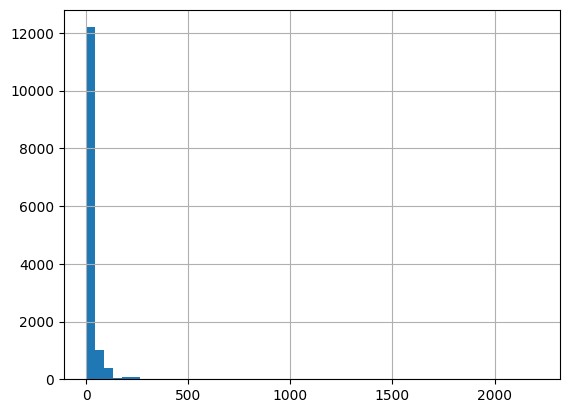

In [111]:

print('After coercion: \n', dfj['Sentence'].describe(),'\n') # Describe the numeric variable
dfj['Sentence'].hist(bins = 50) # Histogram of the variable values
print('Total Missings: \n', sum(dfj['Sentence']),'\n') # How many missing values are there?

<Axes: xlabel='SentenceTypeAllChargesAtConvictionInContactEvent', ylabel='Sentence'>

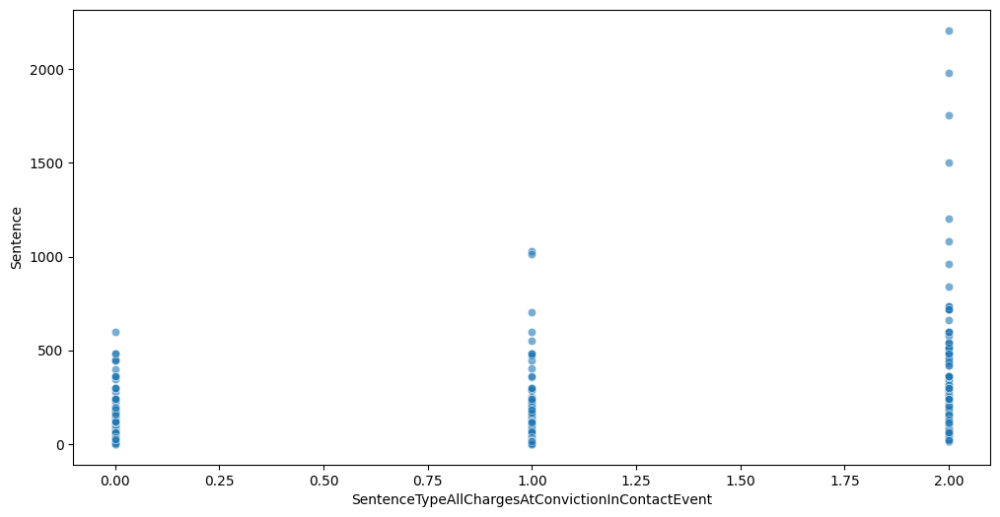

In [115]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 6))

# Create a scatter plot
sns.scatterplot(data=dfj,
                x='SentenceTypeAllChargesAtConvictionInContactEvent',
                y='Sentence',
                alpha=0.6)
# used stack

Not quite sure what this means to be honest but I can see there is more variation among the imposed sentences as the sentence type at conviction increases (i just don't know what this variable means and the code book wouldn't load for me for some reason so i couldn't check there)  

I apologize - this is not my best work and I want to eventually try and clean the data better using the code book, but I honestly procrastinated on this assignment. I can't ever make it to your Wednesday office hours because I have class, but I'm going to stick around on Monday to ask you more questions about this, if thats ok.

- Anna